# IMA207 - Practical work on SAR statistics

### Emanuele DALSASSO, Florence TUPIN, Cristiano ULONDU MENDES, Thomas BULTINGAIRE

### Statistics and despeckling

The practical work is divided in 3 parts

- A. empirical checking of the distributions seen in course for synthetic speckle
- B. computation of equivalent number of looks using images of physically homogeneous areas
- C. spatial multi-looking and implementation of the Lee filter

You have at your disposal several images of various areas acquired by different acquisition modes.
- An oceanfront in São-Paulo acquired by Sentinel-1 sensor (ESA) in GRD (Ground Range Detected) mode
- A farmland near from Bologne (Italy) acquired by TerraSAR-X sensor (ESA) in MGD (Multi Look Ground Range Detected) mode
- An area near from Rome acquired by TerraSAR-X sensor (ESA) in SLC (Single Look Complex) mode
- A temporal stack of images acquired at Flevoland in Netherlands by Alos sensor (JAXA) in SLC mode

Some useful functions are available in the file *mvalab.py*.

### Name: **Giovanni BENEDETTI DA ROSA**

#### Instructions

To solve this practical session, answer the questions below. Then export the notebook with the answers using the menu option **File -> Download as -> Notebook (.ipynb)**. Then [submit the resulting file on e-campus by next week.

### Import the libraries and packages we are going to use
The following cell imports all that is going to be necessary for the practical work

In [2]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


In [3]:
import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath

plt.rcParams['figure.figsize'] = [15, 15]
plt.rcParams['figure.max_open_warning'] = 30

## A. Single look data distributions

In this part, we will simulate an SLC (Single Look Complex) SAR image representing an homogeneous area and analyze the pdfs of its intensity and phase.

#### Single look data simulation

According to the Goodman model, the real and imaginary parts of each pixel of an SLC SAR image are independent and identically distributed according to a Gaussian distribution centered and of variance equal to the reflectivity of the pixel divided by 2.\
Choose randomly a reflectity value $R$ in the interval $[100, 200]$ and create a SLC SAR image of size $150\times 150$ representing an homogeneous area of reflectivity $R$.

Affichage d'une image reelle
plt.show dans visusar : image 150 x 150


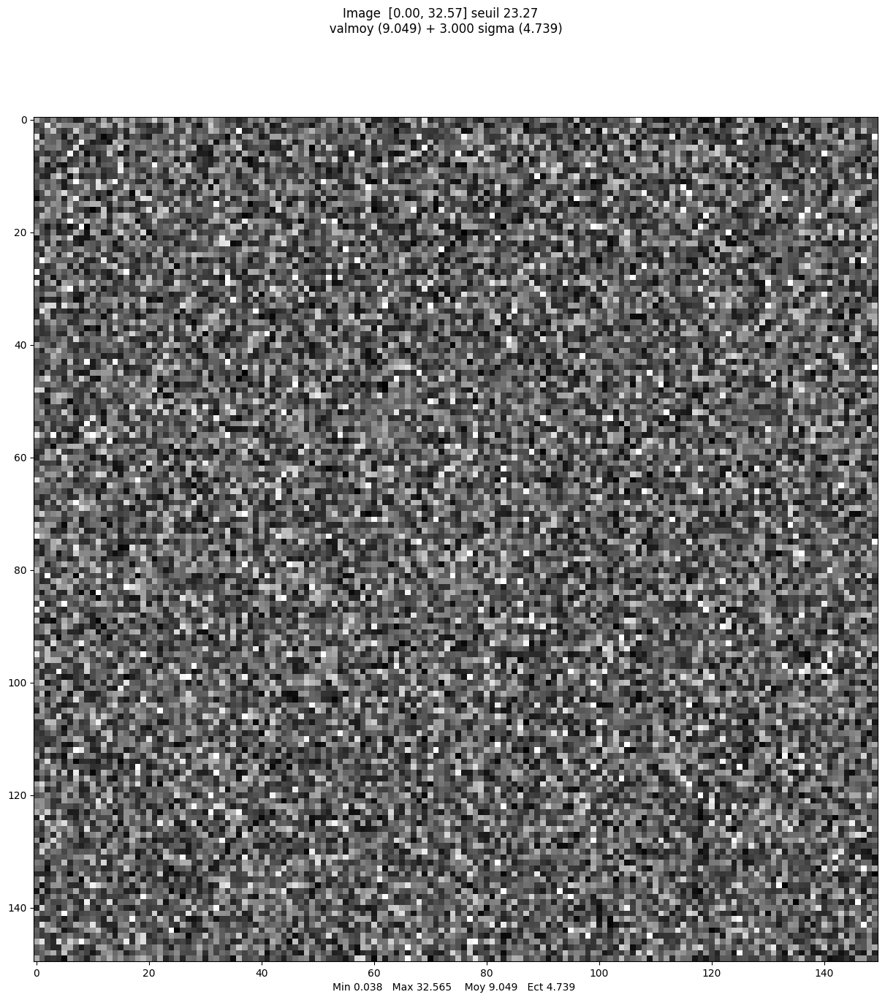

array([[15.64629266,  9.47506058,  7.18380721, ..., 10.47332779,
         7.85311689,  7.12238351],
       [ 5.71519992,  7.85489456, 21.35971858, ..., 11.10385384,
         9.46836266,  7.17007062],
       [ 8.36452275,  5.67399217, 11.28697978, ..., 17.0747116 ,
         6.92009893,  8.13399291],
       ...,
       [ 8.383822  , 11.1271144 ,  6.67270378, ...,  7.92131423,
        13.08064304, 15.48236034],
       [ 7.34908671,  9.02810272, 12.35911249, ...,  1.91244844,
        15.26558248,  3.04131832],
       [15.79110473,  8.95898382,  4.30838009, ..., 13.78233695,
         5.75088462,  6.72366556]])

In [4]:
# Chose the reflectivity of the homogeneous area
R = np.random.uniform(100,200) #complete

# Simulate the corresponding SLC image
ima_slc = np.random.normal(0, np.sqrt(R/2), (150, 150)) + 1j*np.random.normal(0, np.sqrt(R/2), (150, 150))
mvalab.visusar(np.abs(ima_slc))

#### Data distributions for an homogeneous area

compute the distribution of the phase and intensity of your image.
Then, estimate the coefficient of variation:  
$\gamma=\frac{\sigma}{\mu}$ using intensity data (square of the modulus of the complex field)

In [5]:
# Compute the intensity and the phase
ima_int = np.abs(ima_slc)**2 #complete
ima_ph = np.angle(ima_slc) #complete

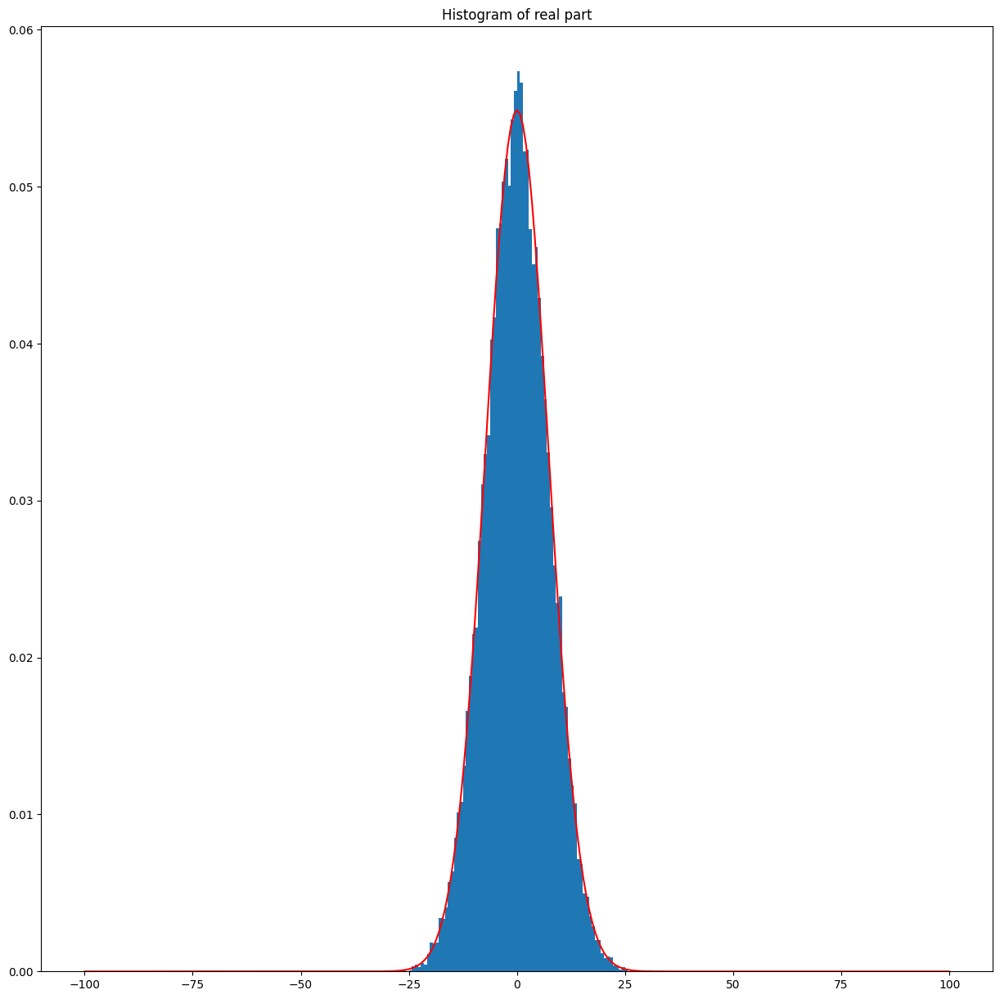

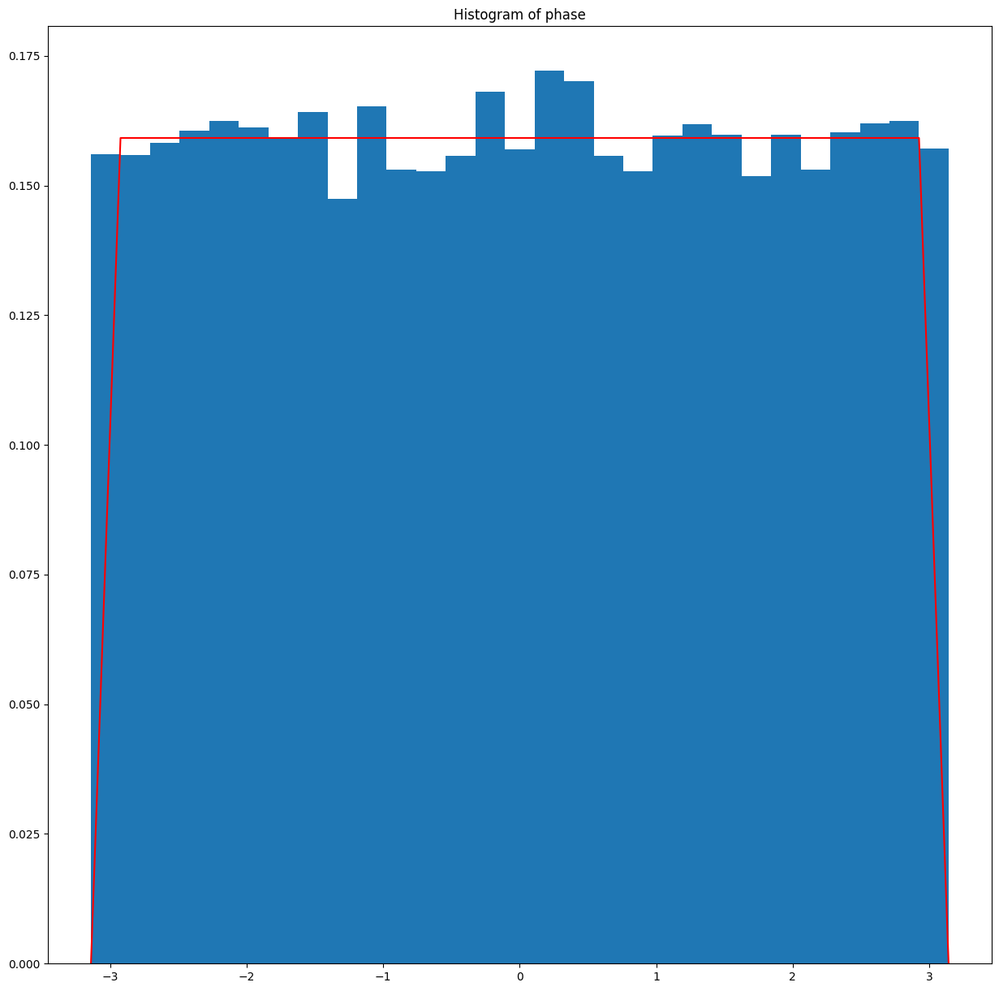

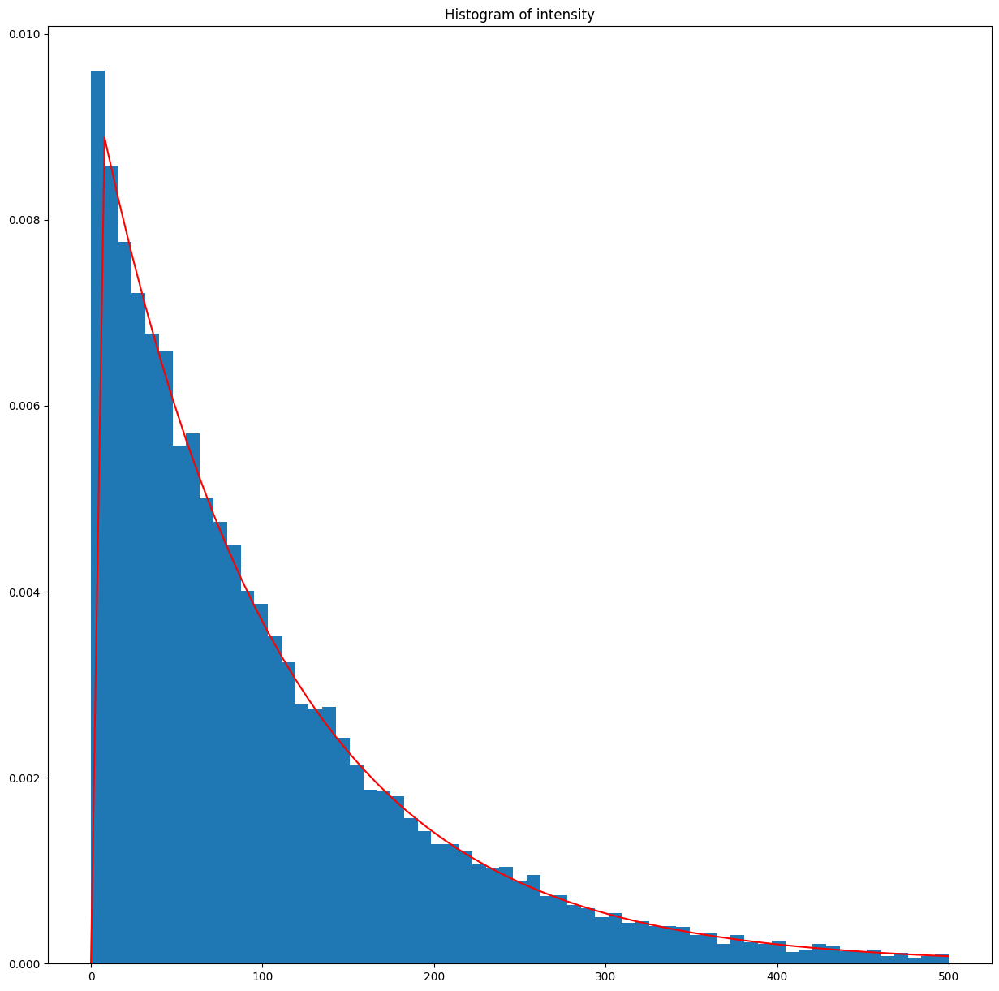

In [6]:
# Plot the histograms and verify they match the theoretical distribution
# Use the right range of values to plot the histogram
# Choose the right distribution to do the fitting

# fitting of the distributions
# use the following ones :
# Gaussian pdf : scipy.stats.uniform
# Rayleigh pdf : scipy.stats.rayleigh
# Exponential pdf : scipy.stats.expon

# example for real part of the data
plt.figure()
_, bins, _ = plt.hist(np.real(ima_slc).ravel(), bins='auto',
                      density=True, range=[-100, 100])  
# Gaussian distribution
mu, sigma = scipy.stats.norm.fit(np.real(ima_slc))
best_fit_line = scipy.stats.norm.pdf(bins, mu, sigma)
plt.plot(bins, best_fit_line,  markersize=3, color='r')
plt.title('Histogram of real part')
plt.show()

# complete for phase data: Uniform distribution
plt.figure()
_, bins, _ = plt.hist(ima_ph.ravel(), bins='auto',
                        density=True, range=[-np.pi, np.pi])
# Uniform distribution
mu, sigma = scipy.stats.uniform.fit(ima_ph)
best_fit_line = scipy.stats.uniform.pdf(bins, mu, sigma)
plt.plot(bins, best_fit_line, markersize=3, color='r')
plt.title('Histogram of phase')
plt.show()

# complete for intensity data: Exponential (Gamma) distribution
plt.figure()
_, bins, _ = plt.hist(ima_int.ravel(), bins='auto',
                        density=True, range=[0, 500])
# Exponential distribution
mu, sigma = scipy.stats.expon.fit(ima_int)
best_fit_line = scipy.stats.expon.pdf(bins, mu, sigma)
plt.plot(bins, best_fit_line, markersize=3, color='r')
plt.title('Histogram of intensity')
plt.show()

In [7]:
# Compute the coefficient of variation on the homogeneous area in intensity

m_I = np.mean(ima_int) #complete
sigma_I = np.std(ima_int)  #complete
coeff_var_I = sigma_I/m_I
print(coeff_var_I)

0.9998273790800893


### Question A.1.

Did you find the distributions seen in the course ? (recapitulate them).
Did you find the correct value for the coefficient of variation ? Could this coefficient be less than the theoretical value ?

### Answer A.1.

Yes, the data histograms generated using the Goodman model were compared to their respective theoretical distributions, and a very good match was observed:



* The real part of the image follow a Gaussian distribution: $p(\text{Re}(z) | \sigma) = \frac{1}{\sqrt{2\pi}\sigma} \exp(-\frac{\text{Re}(z)^2}{2\sigma^2}) \rightarrow p(\text{Re}(z) | R) = \frac{1}{\sqrt{\pi R}} \exp(-\frac{\text{Re}(z)^2}{R})$

*  The phase of the image follow an uniform distribution: $p(\phi | R) = \frac{1}{2\pi}$

* The intensity of the image follow an exponential distribution: $p(I | R) = \frac{1}{R}\exp(-\frac{I}{R})$

Aditionally, it can be confirmed that the coefficient of variation is close to one, as described by the model $\gamma_I = \frac{\sigma_I}{\mathbf{E}[I]} = \frac{R}{R} = 1$, once is given that  $\mathbf{E}[I] = R$ and $\text{Var}[I] = R^2$.

Fo what we could observe with more than one is experiment is that the distribuition fits well with the data and that the coefficient is close to one.

## B. Computation of the Equivalent Number of looks on homogeneous areas
In this part you have at your disposal 2 images of a part a ocean (São-Paulo) and a part of a field (Bologne, Italy). The first is acquired by Sentinel-1 GRD, and the second by TerraSAR-X GRD. The multi-looking has been done by the data provider (ESA, European Space Agency).

Use the value of the coefficient of variation to find the Equivalent Number of Looks (ENL) of the Sentinel-1 GRD and TerraSAR-X GRD data.
The formula is :
- $\gamma_I=\frac{1}{\sqrt{L}}$ for intensity data

In [8]:
# Download the images
!wget "https://partage.imt.fr/index.php/s/M3yeW5ozcsHyigR/download/s1_grd_saopaulo.npy"
!wget "https://partage.imt.fr/index.php/s/TTRfS6XKCzSM6cS/download/tsx_grd_bologne.npy"

'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


intensity image


Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


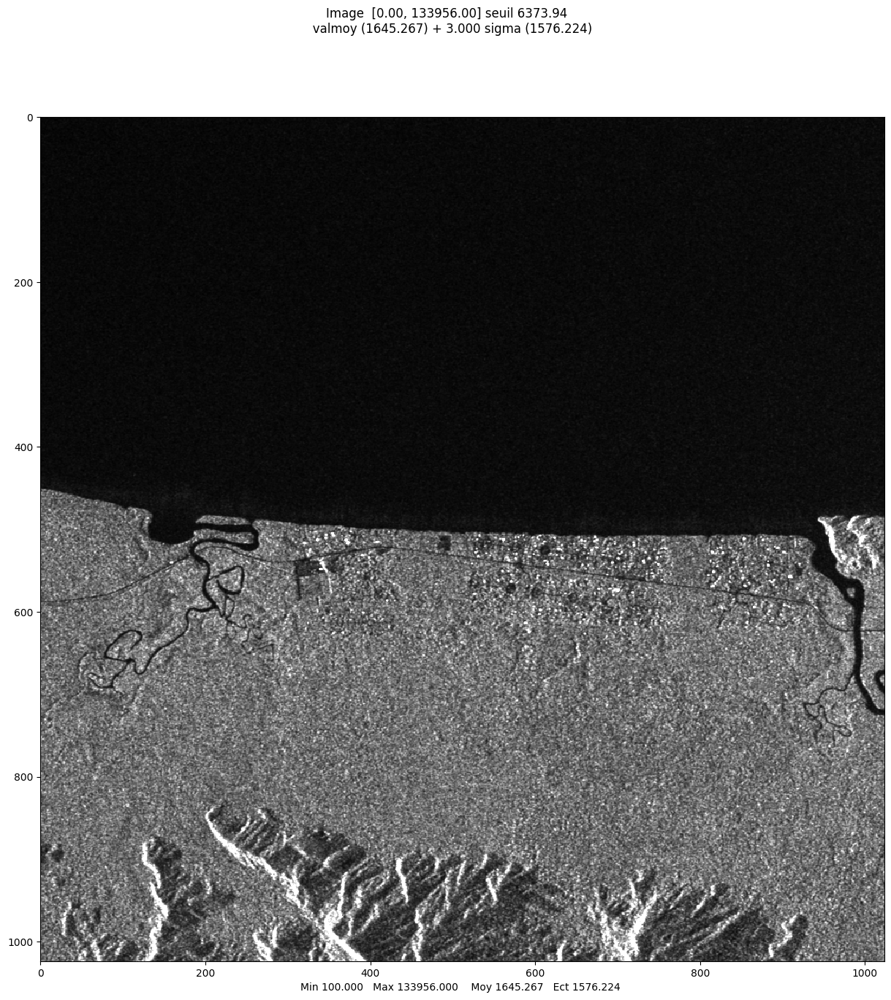

Affichage d'une image reelle
plt.show dans visusar : image 250 x 250


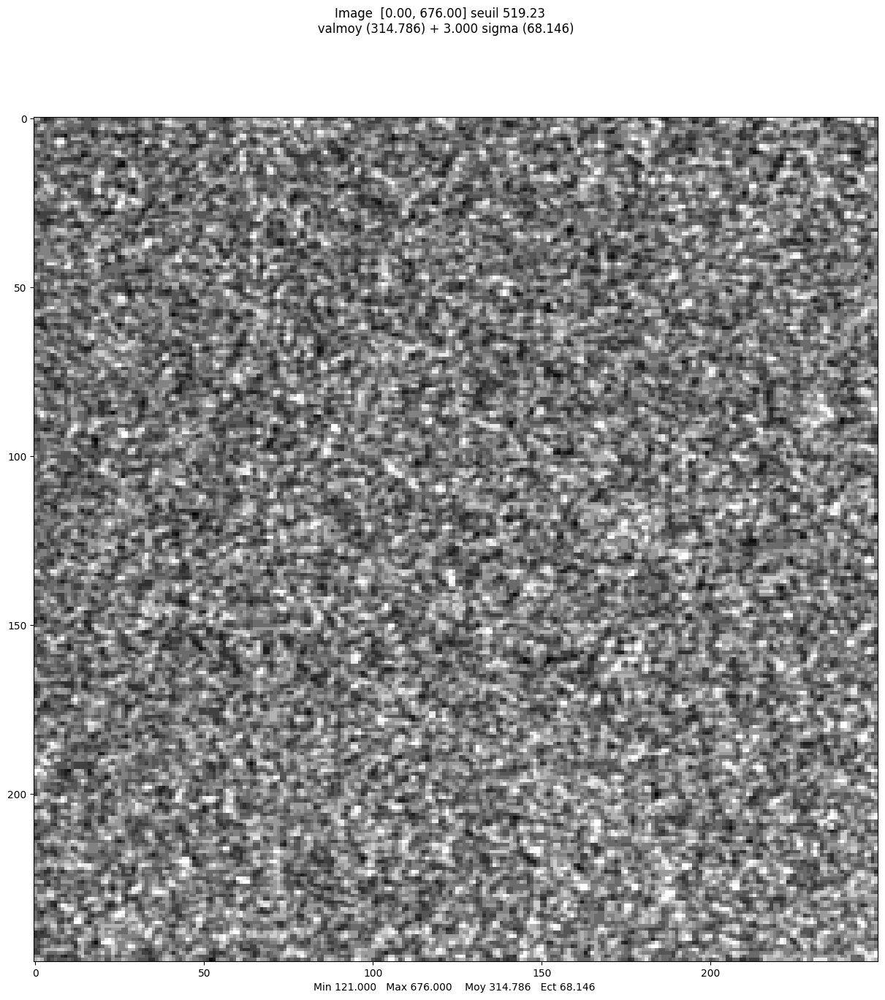

--- coeff var and L ---
0.21648477
21.33758686719461


In [9]:
im_s1grd = np.load("s1_grd_saopaulo.npy").astype(np.float32) #amplitude
print('intensity image')
mvalab.visusar(im_s1grd**2)
im_s1grd = im_s1grd**2
im_s1grd_mer = im_s1grd[50:300, 100:350]
mvalab.visusar(im_s1grd_mer)

# compute coefficient of variation and number of looks
coeff_var_grd = np.std(im_s1grd_mer) / np.mean(im_s1grd_mer)  # Coefficient of variation
L_grd = 1 / coeff_var_grd**2  # Number of looks
print('--- coeff var and L ---')
print(coeff_var_grd)
print(L_grd)

intensity image
Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


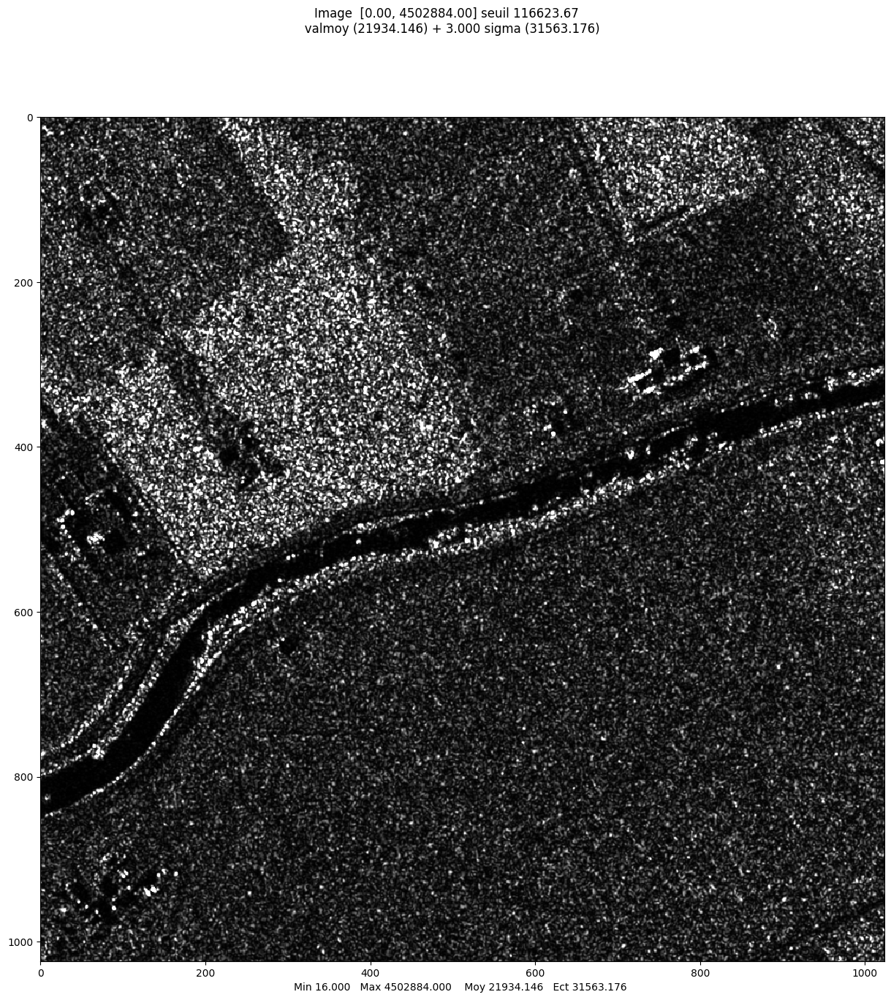

Affichage d'une image reelle
plt.show dans visusar : image 250 x 250


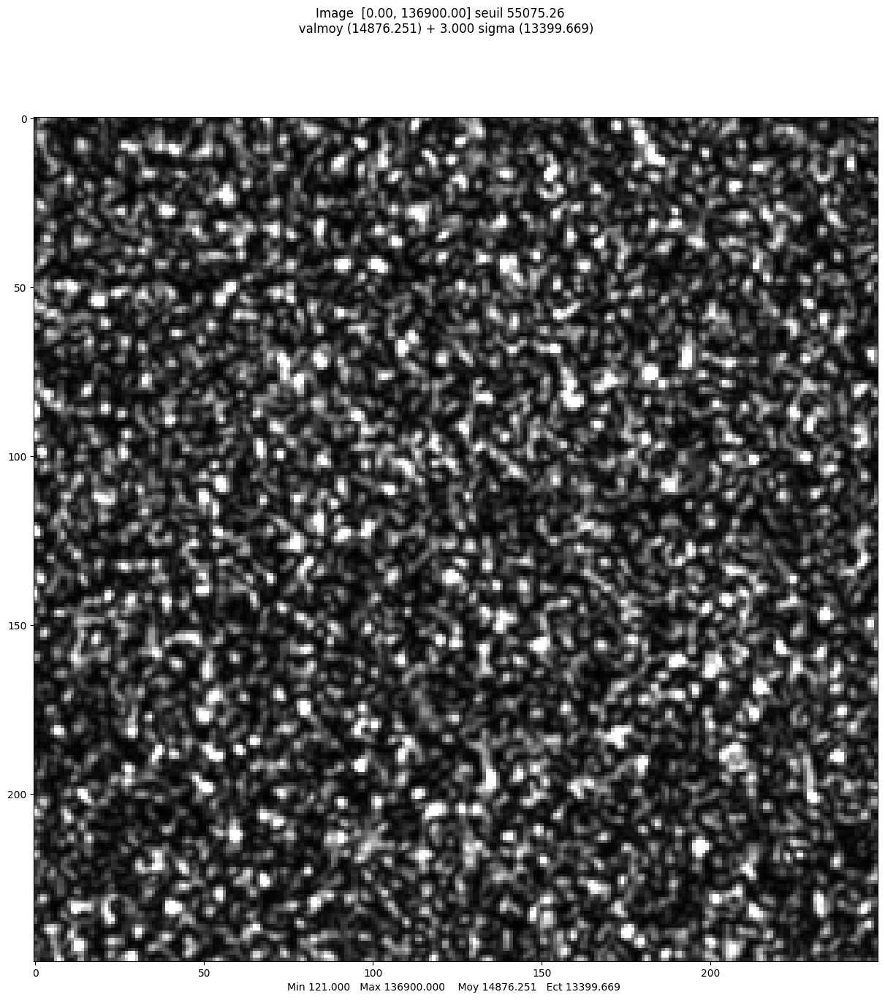

--- coeff var and L ---
Estimated coefficient of variation:0.90074235
Estimated number of looks:1.2325337872691504


In [10]:
im_tsxgrd = np.load("tsx_grd_bologne.npy").astype(np.float32) #amplitude
print('intensity image')
mvalab.visusar(im_tsxgrd**2)
im_tsxgrd = im_tsxgrd**2
im_tsxgrd_champ = im_tsxgrd[700:950, 300:550]
mvalab.visusar(im_tsxgrd_champ)

# compute coefficient of variation and number of looks
coeff_var_grd = np.std(im_tsxgrd_champ ) / np.mean(im_tsxgrd_champ )  # Coefficient of variation
L_grd = 1 / coeff_var_grd**2  # Number of looks
print('--- coeff var and L ---')
print('Estimated coefficient of variation:' +str(coeff_var_grd))
print('Estimated number of looks:' +str(L_grd))

### Question B.1
Comment the number of looks you have found for GRD date from Sentinel-1 and TerraSAR-X (is it an integer value ? why not ? what does it mean ?).

### Answer B.1

The number of views found were not integers, since the samples(pixels) are not completely *i.i.d*. The approximate number of looks is estimated to be $21$ for the Sentinel-1 image and $1$ for the TerraSAR-X image.

## C. Spatial multi-looking and implementation of the Lee filter

In this part we will try simple speckle reduction method using the following step :
- first we will compute a mean filter
- then we will compute the local coefficient of variation (using the same size for the moving window)
- finally we will combine these two results to obtain the Lee filter.

## C.1 Computation of the mean filter
Compute the mean filter using a 2D convolution.

In [11]:
# Download the image
!wget "https://partage.imt.fr/index.php/s/cbRqjnSJEfD2zJ8/download/tsx_slc_rome.npy"

'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


Visualizing TerraSAR-X SLC image of Rome in amplitude
Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 1024 x 1024


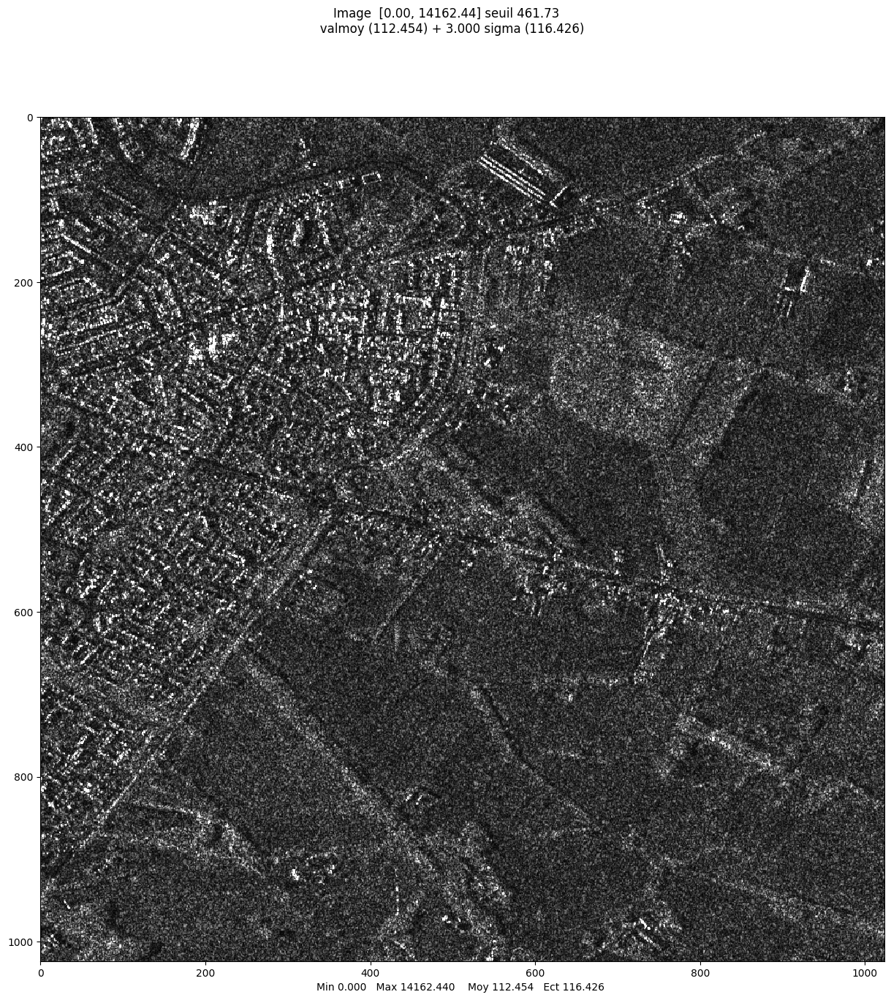

Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


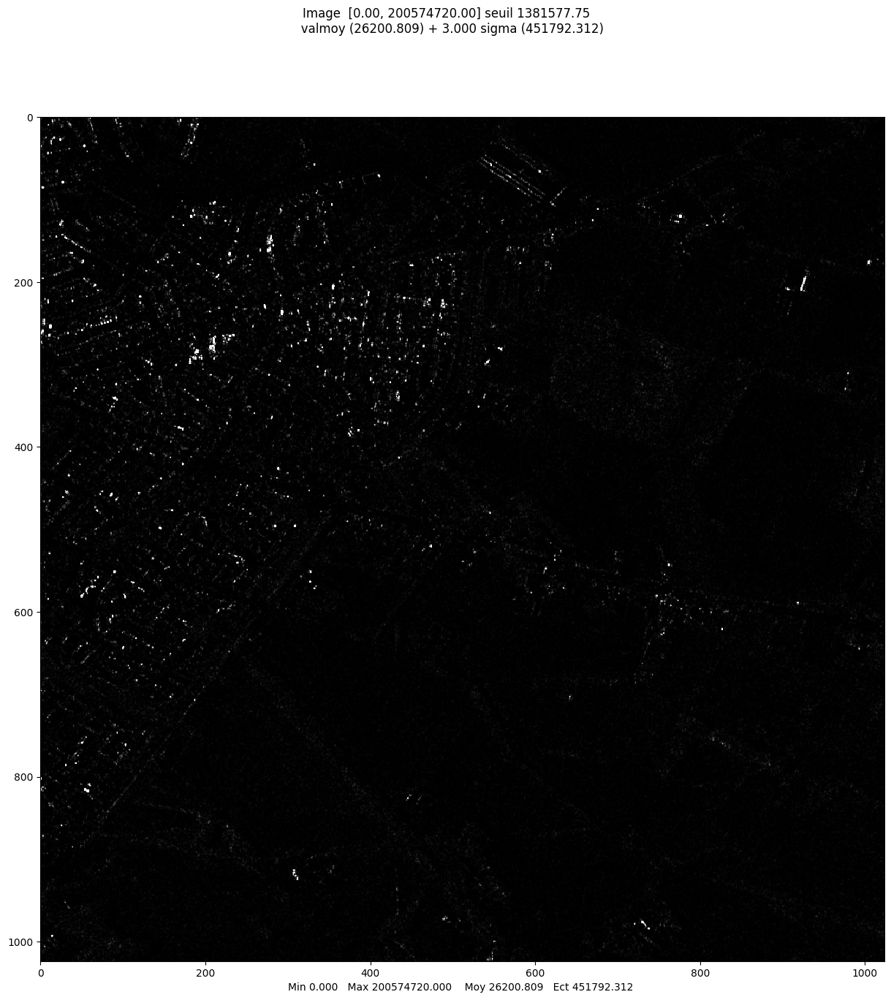

Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


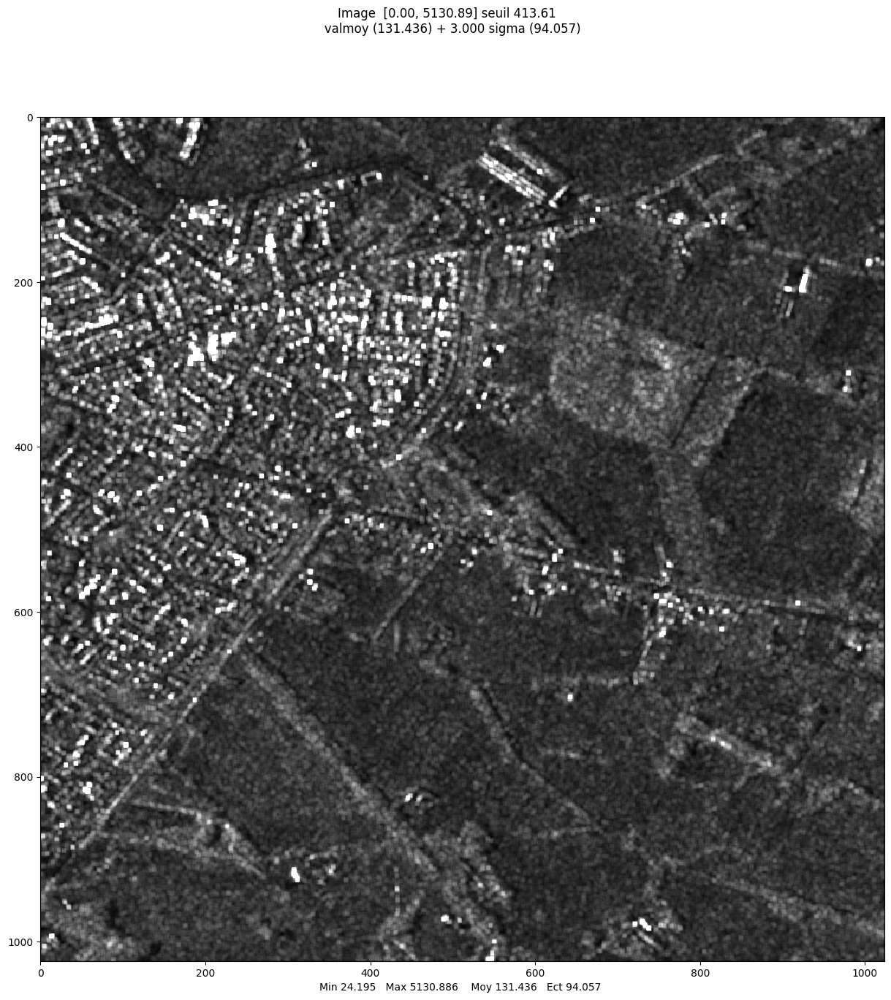

array([[244.69352595, 246.28845207, 247.00073203, ...,  59.00237275,
         45.53152722,  38.87158314],
       [255.80148874, 257.44941565, 258.27992881, ...,  62.28515052,
         49.21991417,  40.5117264 ],
       [264.1736587 , 265.90276783, 266.84565192, ...,  66.19002928,
         53.12362903,  42.52857822],
       ...,
       [ 66.5059401 ,  76.51222157,  82.94239   , ..., 104.46549647,
         98.12359529,  96.90077379],
       [ 63.74511803,  73.15244394,  78.94580454, ...,  87.86580629,
         80.89449867,  79.50547102],
       [ 55.38989174,  62.1247143 ,  68.50839457, ...,  67.49933331,
         62.81273754,  61.61947744]])

In [12]:
from scipy.ndimage import convolve

ima_tsxslc = np.load("tsx_slc_rome.npy") #amplitude

print("Visualizing TerraSAR-X SLC image of Rome in amplitude")
mvalab.visusar(ima_tsxslc)

# take the intensity
ima_int = np.abs(ima_tsxslc)**2
mvalab.visusar(ima_int)

# create the average window
size_window = 5
mask_loc = np.ones((size_window, size_window))/(size_window**2)

# compute the mean image (intensity data)
ima_int_mean = scipy.signal.convolve2d(ima_int, mask_loc, mode='same')

# compute the amplitude image
ima_amp_mean = np.sqrt(ima_int_mean)

# display the result
mvalab.visusar(ima_amp_mean)

### Question C.1
What is the effect of the mean filter ? (advantages and drawbacks). What is the influence of the window size ?

### Answer C.1

At the same time that the mean filter reduce the variance in homogeneous regions, that can can denoise the images, it also reduces the variance in heterogeneous regions, loosing the information on the image. So the utility of this filter is more suitable to more homogeneous regions. Of course the ammount of information lost depends on the size of the the kernel of the filter; If it's higher i'ts more agressive.

## C.2 Lee filter

Given a neighborhood, the Lee filter of an image $I_s$ can be computed by the following steps:

*   Compute the local mean of the image $\hat{\mu}_{s}$
*   Compute $k_s$ given by:
$$
  k_s=1- \frac{\gamma_{Sp}^2}{\hat{\gamma}_s^2}
$$
where $\gamma_{Sp}$ is the theoretical value of the coefficient of variation for a pure speckle ($\gamma_{Sp}=\frac{1}{\sqrt{L}}$ for a L-look intensity image), and $\hat{\gamma}_s$ is the empirical value of the coefficient of variation for the given neighborhood.
*   Compute the final filtered image
$$
  \hat{I}_s= \hat{\mu}_{s}+k_s (I_s-\hat{\mu}_{s})
$$

Create a function performing Lee filter on an image, for a given neighborhood and number $L$ of look.

Then, knowing that a SLC image is a 1-look image, compute the Lee filter on the intensity image of "ima_tsxslc"

local mean
Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


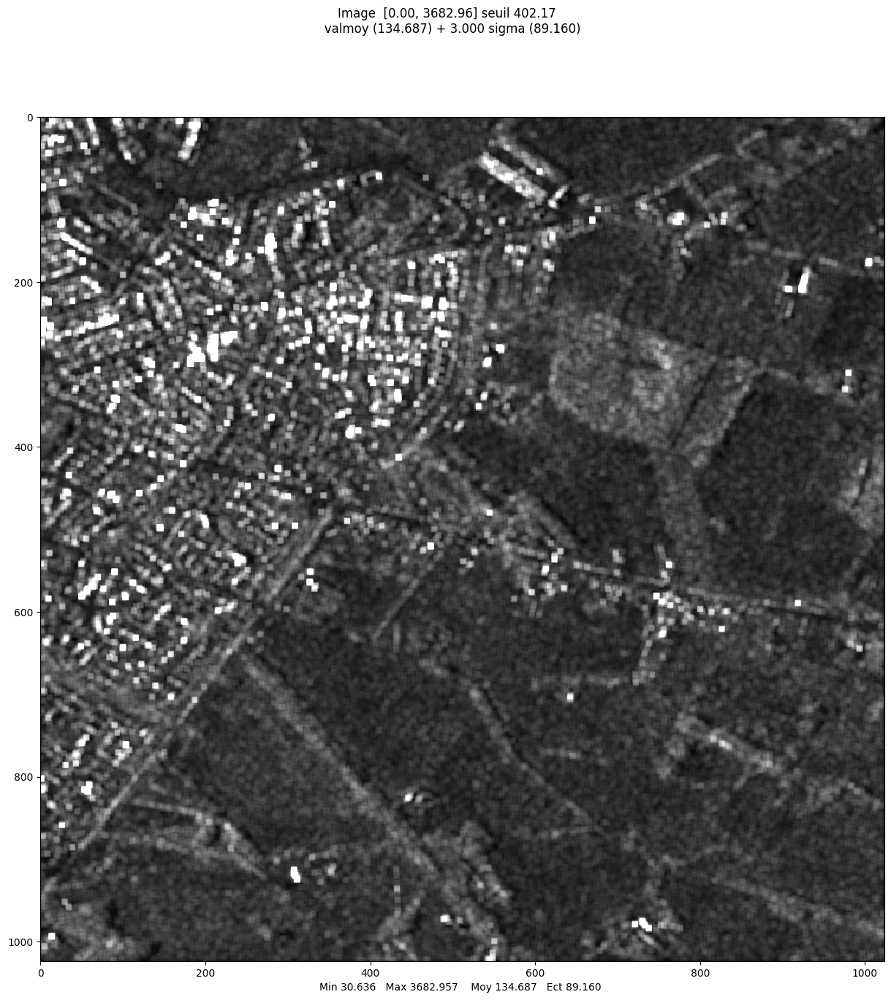

local variance
Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


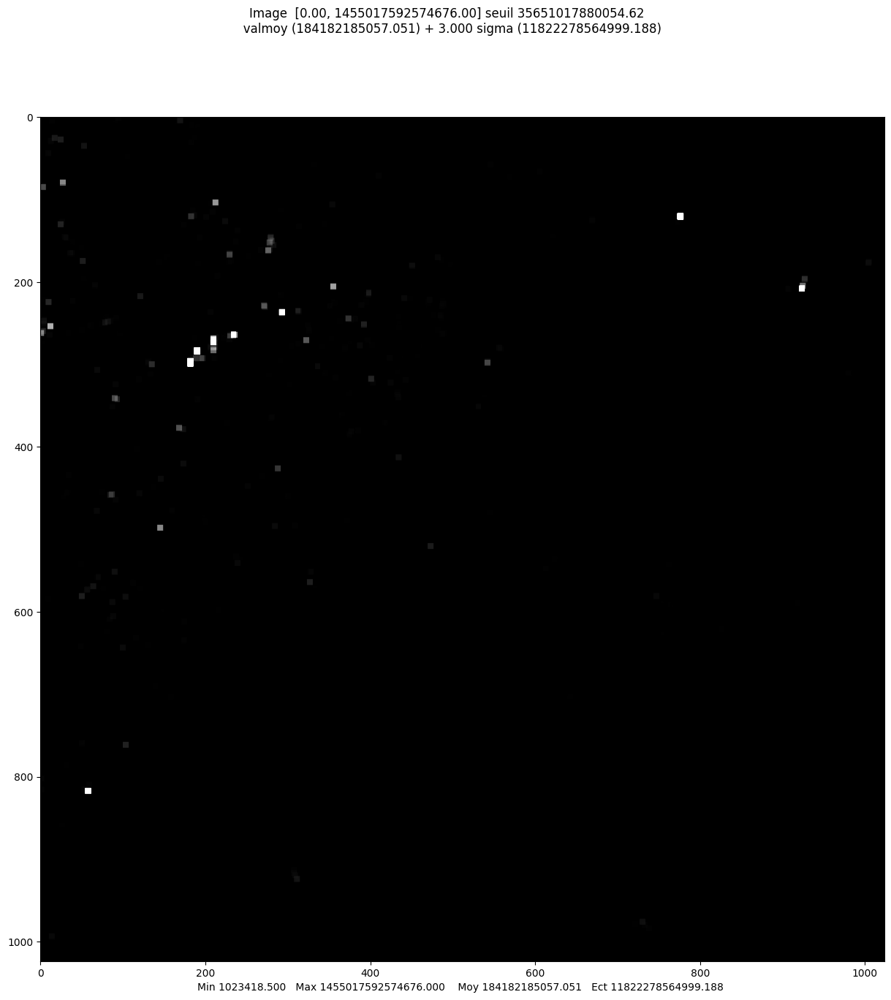

coefficient of variation
Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


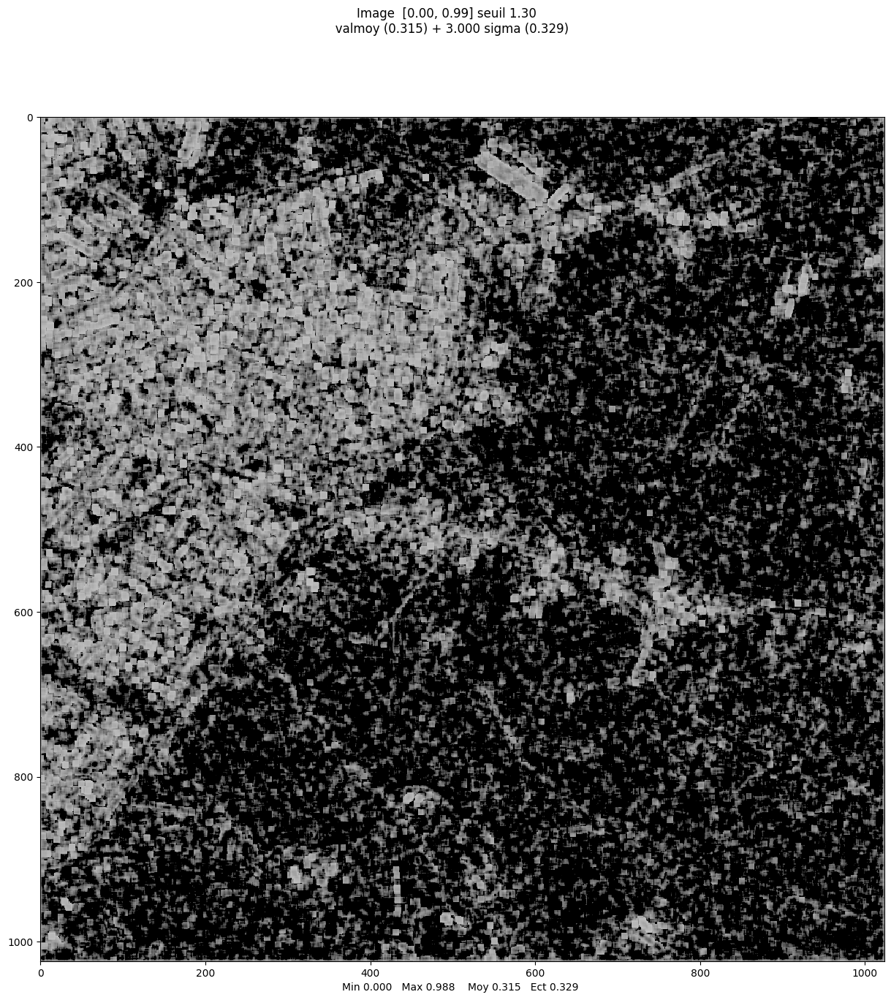

Filtered with Lee filter
Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


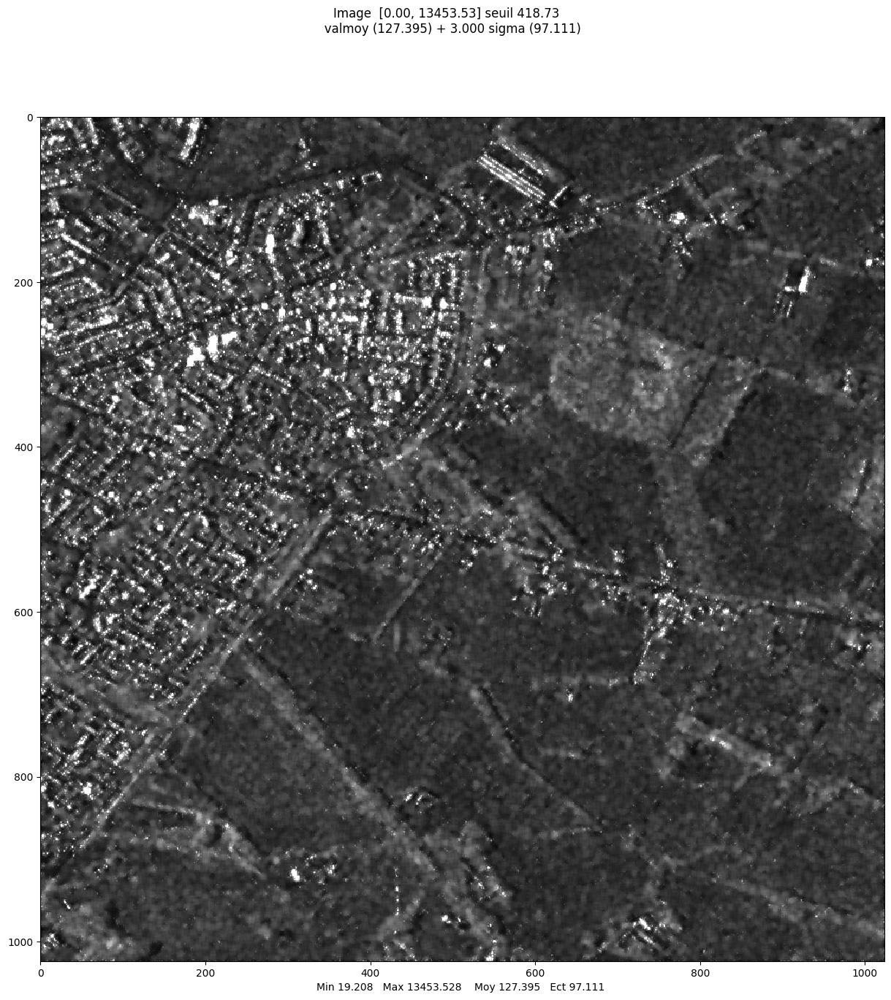

Original image
Affichage d'une image reelle
plt.show dans visusar : image 1024 x 1024


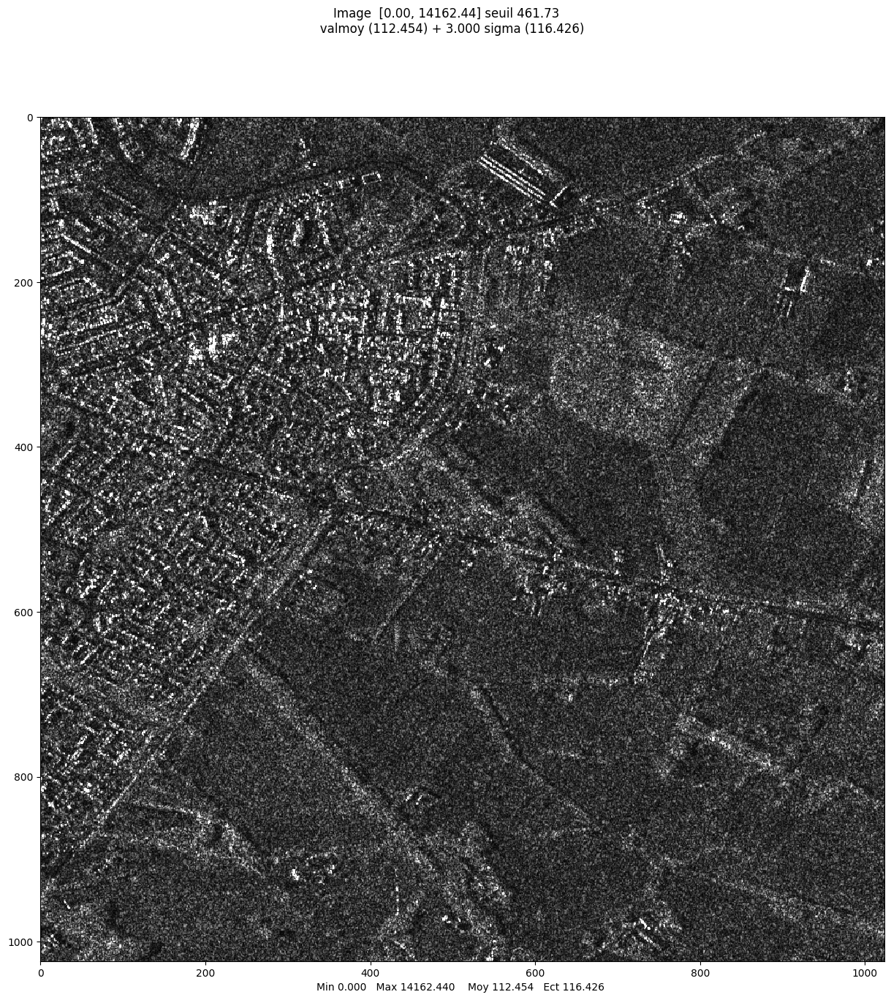

array([[133.76472473, 329.56030273, 461.73059082, ...,  65.19202423,
         92.89241028, 124.0362854 ],
       [190.07893372, 461.73059082, 461.73059082, ...,  36.12478256,
         70.43436432,  26.24880981],
       [244.7611084 , 461.73059082, 394.60614014, ...,  42.44997025,
         17.46424866,  21.18962097],
       ...,
       [104.44615936,  92.84934235,  62.93647766, ..., 150.7116394 ,
        108.5771637 ,  30.80584335],
       [ 89.55445099, 122.93087769, 101.86265564, ..., 111.50785065,
         68.68041992, 116.66190338],
       [ 54.7083168 ,  57.        , 116.01724243, ..., 105.        ,
         41.34005356, 126.40016174]])

In [13]:
def lee_filter(im, neighborhood=7, L=1, visualize=False):

  # Mask
  mask = np.ones((neighborhood, neighborhood)) / (neighborhood**2) #complete

  # Compute local mean image
  im_mean = scipy.signal.convolve2d(im, mask, mode='same') #complete

  # Compute local coefficient of variation (thanks to local variance and local mean)
  im_sqr_mean = scipy.signal.convolve2d(im**2, mask, mode='same')
  im_var = im_sqr_mean - im_mean**2#complete
  gamma_sp = 1 / np.sqrt(L)
  coeff_var_emp = np.sqrt(im_var) / im_mean
  ks = 1 - (gamma_sp**2 / (coeff_var_emp**2 + 1e-10)) #complete
  ks = np.clip(ks, 0, 1)

  # Compute Lee filter
  filtered_im = im_mean + ks * (im - im_mean) #complete

  # Visualizations
  if visualize:
    print("local mean")
    mvalab.visusar(np.sqrt(im_mean))
    print("local variance")
    mvalab.visusar(im_var)
    print("coefficient of variation")
    mvalab.visusar(np.sqrt(ks))

  return filtered_im

lee_filtered_int = lee_filter(ima_int, neighborhood=7, L=1, visualize=True) #complete
print("Filtered with Lee filter")
mvalab.visusar(np.sqrt(lee_filtered_int))
print("Original image")
mvalab.visusar(np.sqrt(ima_int))

### Question C.2
Which information is enhanced in the image of the local standard deviation ? In the image of the local coefficient of variation ? Which one is the more useful ?

### Answer C.2

The  reflectivity is proportional to the local *std*, and thus doesn't measure local heterogenity like it would on an optical image. When we normalize with the local mean we obtain the coefficient of variation which is more representative with respect to heterogenities and homogeneties parts in the image. This idea is applied in the Lee filter: when the coefficient of variation is close to 1 the area of the image can be safely averaged; on the other hand when to coefficient is close to 0 this area should be preserved. 


### Question C.3

Compare the results of the mean filter and the Lee filter. Study the influence of the size of the window of the filters.


### Answer C.3

As expected the Lee filter behaves much better than the mean filter, averaging constant areas and keeping the information of the contours ans heterogenes regions. After doing some tests, we can check that we reduce a lot the window size smaller areas are averaged, preserving more borders, but reducing less noise.

## Filtering of image "Lely" and comparison with a deep learning algorithm
In this part, we will repeat the process done above to denoise a crop of image "Lely" using the Lee filter. Then, we will compare it with the result of a deep learning algorithm called SAR2SAR (https://arxiv.org/abs/2006.15037).

## C.4 Denoised image: SAR2SAR
The Lee filter presents some limits. More recent approaches to suppress noise rely on sofisticated algorithms. You can plot the image of Lely denoised using a deep learning algorthm called SAR2SAR and compare visually the result with the image filtered using the Lee filter.
  

In [14]:
# Download the image
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim

'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


imz2mat : version janvier 2018.  Fichier à ouvrir : lely_tuple_multitemp.IMA
Fichier .dim version longue (lecture 3eme parametre) 
Fichier .dim version longue (lecture 4eme parametre)
Dans ximaread : lecture du canal 0/25
image en .IMA
image en .IMA
Fichier .dim version longue (lecture 3eme parametre) 
Fichier .dim version longue (lecture 4eme parametre)
image en .ima  512   512   canaux: 25  verif :  1
512 512
-type CFLOAT
lecture de  lely_tuple_multitemp.IMA  en quelconque 512 512 25  offset  0 <f 4  complex 1 blocksize 2097152
Boucle de lecture entre 0 et 25   sur 25 canaux
Lecture du canal 1/25
Données complexes (standard). Nouvelle version de imz2mat  <f
Lecture du canal 2/25
Données complexes (standard). Nouvelle version de imz2mat  <f
Lecture du canal 3/25
Données complexes (standard). Nouvelle version de imz2mat  <f
Lecture du canal 4/25
Données complexes (standard). Nouvelle version de imz2mat  <f
Lecture du canal 5/25
Données complexes (standard). Nouvelle version de imz2mat 

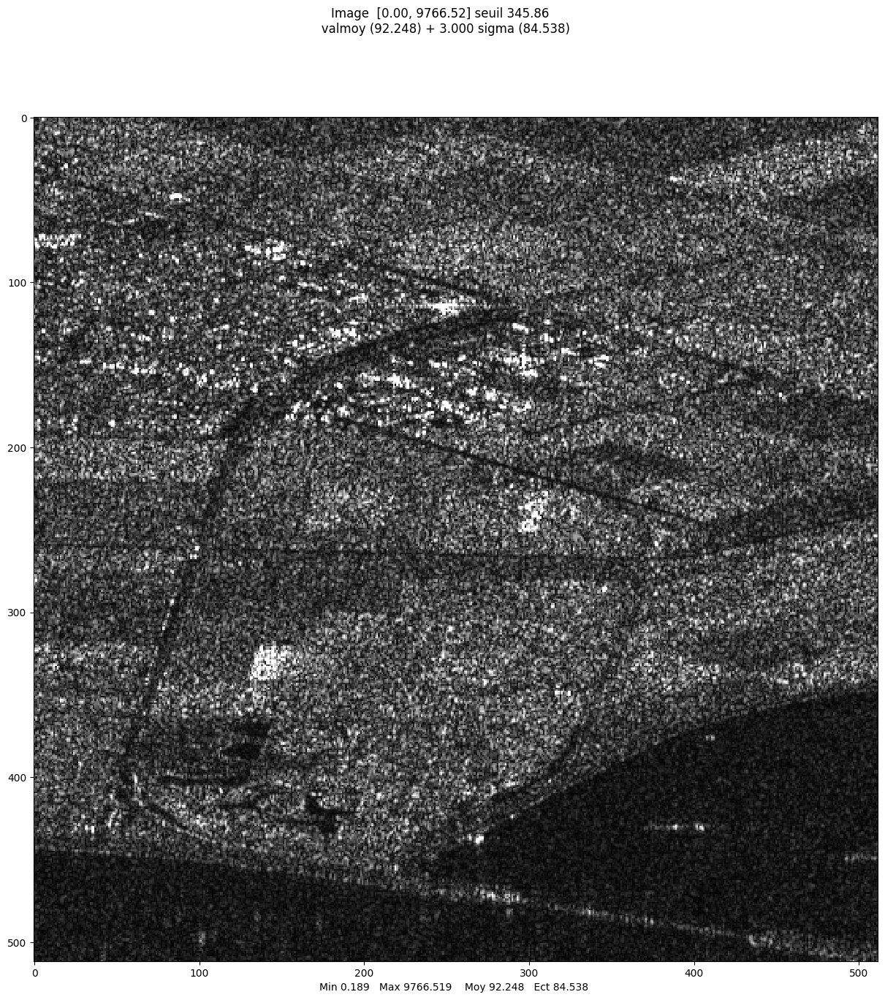

Amplitude of the filtered image
Affichage d'une image reelle
plt.show dans visusar : image 512 x 512


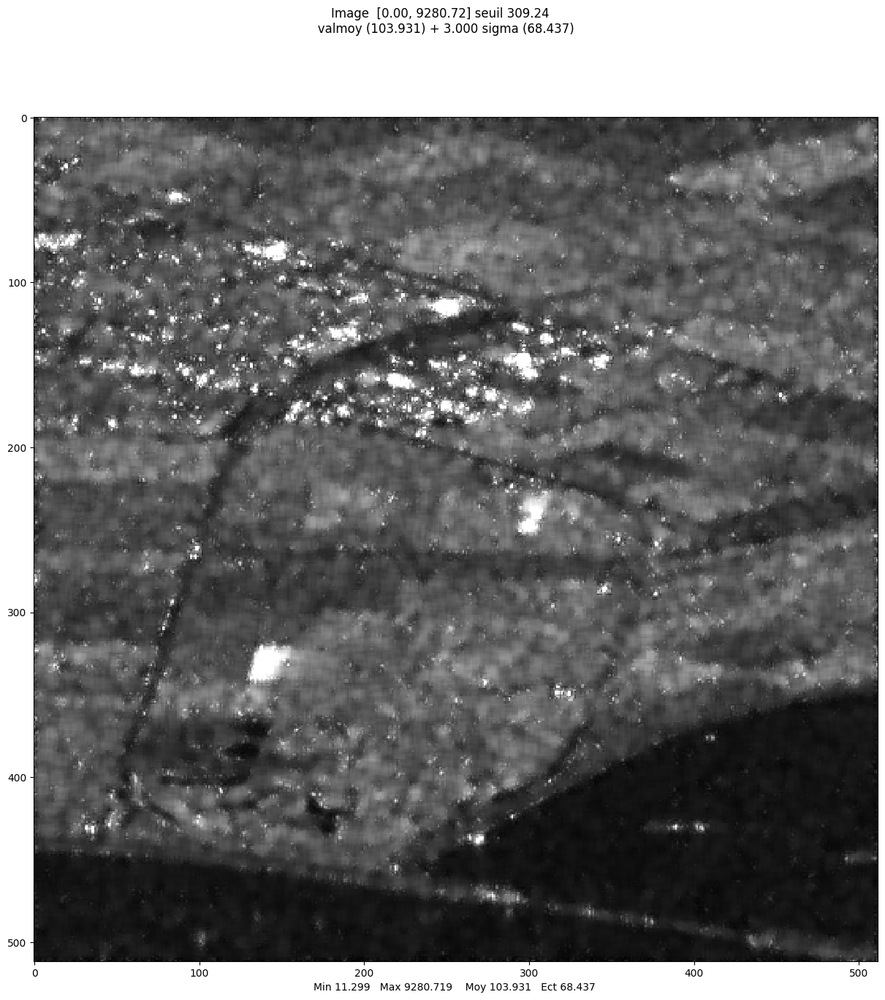

array([[ 77.42145081,  60.57726231,  83.83170578, ...,  43.65446769,
         42.33217855,  46.88156881],
       [ 47.869043  ,  52.86934886,  52.8235984 , ..., 120.65639836,
         90.12296035,  41.31860317],
       [ 56.93129422,  82.0020663 ,  74.30037708, ..., 110.16119263,
        116.76405434,  75.10916861],
       ...,
       [ 29.19809719,  31.70052529,  28.58914586, ...,  73.17288733,
         51.27087521,  62.14106404],
       [ 19.47862472,  31.21831959,  34.60554861, ...,  76.36410083,
         55.47956716,  73.65145118],
       [ 24.60171053,  44.89194795,  19.98769651, ...,  76.06644646,
         35.93479203, 101.22668942]])

In [15]:
part_lely_slc = mvalab.imz2mat('lely_tuple_multitemp.IMA')[0]  # date is on thrid axis of part_lely_slc
part_lely_slc = part_lely_slc[:, :, 0]  # single look complex image

print("SLC image of the Lely stack")
mvalab.visusar(part_lely_slc)

# using your previous code, filter the image part_lely_int with the Lee filter
part_lely_int = np.abs(part_lely_slc)**2
part_lely_int_filtered = lee_filter(part_lely_int, neighborhood=7, L=1, visualize=False)

print("Amplitude of the filtered image")
mvalab.visusar(np.sqrt(part_lely_int_filtered))

'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.
'wget' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


imz2mat : version janvier 2018.  Fichier à ouvrir : lely_tuple_multitemp_SAR2SAR.IMA
Fichier .dim version longue (lecture 3eme parametre) 
Fichier .dim version longue (lecture 4eme parametre)
Dans ximaread : lecture du canal 0/25
image en .IMA
image en .IMA
Fichier .dim version longue (lecture 3eme parametre) 
Fichier .dim version longue (lecture 4eme parametre)
image en .ima  512   512   canaux: 25  verif :  1
512 512
-type FLOAT
lecture de  lely_tuple_multitemp_SAR2SAR.IMA  en quelconque 512 512 25  offset  0 <f 4  complex 0 blocksize 1048576
Boucle de lecture entre 0 et 25   sur 25 canaux
Lecture du canal 1/25
Données réelles. Nouvelle version de imz2mat  <f
Lecture du canal 2/25
Données réelles. Nouvelle version de imz2mat  <f
Lecture du canal 3/25
Données réelles. Nouvelle version de imz2mat  <f
Lecture du canal 4/25
Données réelles. Nouvelle version de imz2mat  <f
Lecture du canal 5/25
Données réelles. Nouvelle version de imz2mat  <f
Lecture du canal 6/25
Données réelles. Nouvell

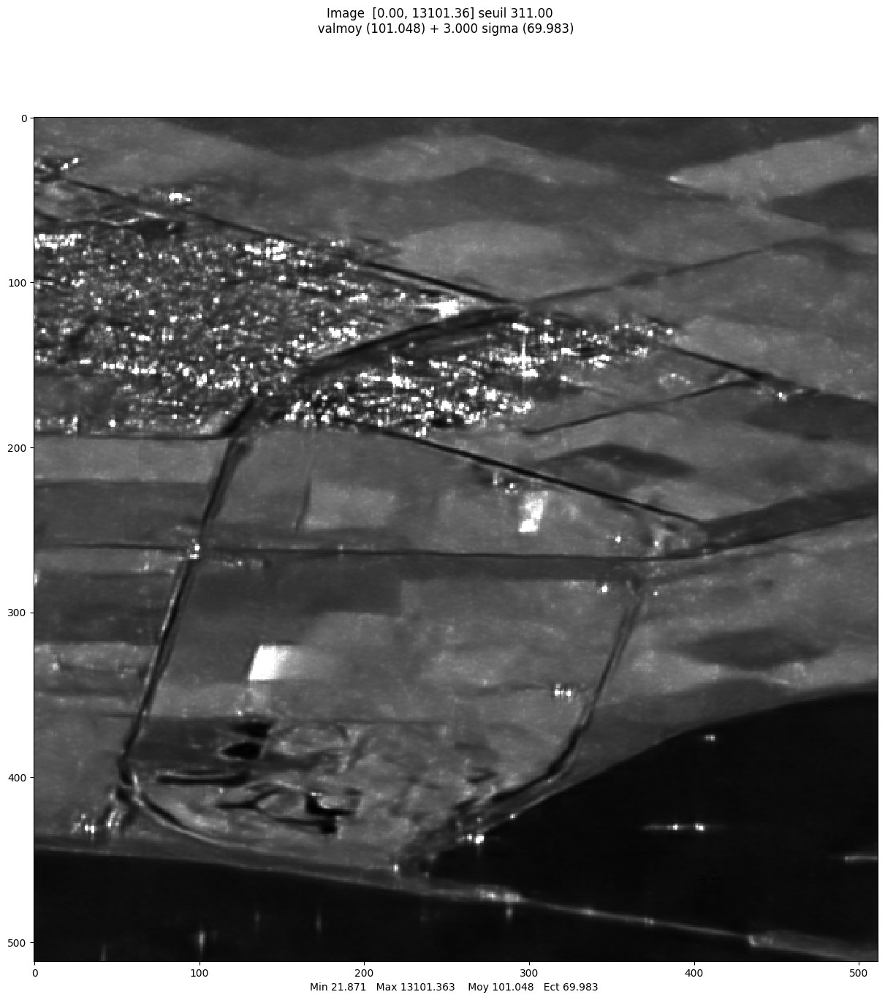

array([[108.26735687, 108.92593384, 117.21216583, ...,  87.13925171,
         89.79171753,  89.75721741],
       [105.54544067, 111.25749207, 116.15348053, ...,  95.23865509,
         96.19988251,  95.58480072],
       [105.72384644, 114.29315186, 116.50016022, ..., 100.59217072,
        100.78230286, 100.22771454],
       ...,
       [ 40.31035233,  38.88003159,  38.09856415, ...,  82.76222992,
         81.49038696,  81.83437347],
       [ 39.99552917,  38.5390358 ,  38.96235657, ...,  84.42482758,
         84.06273651,  83.64545441],
       [ 40.69298935,  38.59126282,  38.61891174, ...,  81.21070862,
         82.10493469,  87.46295166]])

In [16]:
# this image has already been processed by a CNN based filter
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/denoised_SAR2SAR/lely_tuple_multitemp_SAR2SAR.IMA
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/denoised_SAR2SAR/lely_tuple_multitemp_SAR2SAR.dim
im_lely_multitemp_denoised = mvalab.imz2mat('lely_tuple_multitemp_SAR2SAR.IMA')
im1_d = np.abs(im_lely_multitemp_denoised[0][:,:,0]) #amplitude
mvalab.visusar(im1_d)

### Question C.4
Do a comparison between the CNN filtering and the Lee filter. Comment the two results. Are homogeneous areas well restored? Do the methods preserve edges and fine structures? Are artifacts introduced?

### Answer C.4

We can see that the CNN achieves a much better performance than the Lee filter, which makes sense since the filter is less complex than a CNN. As a qualitative result, we can check that the edges/contours are better preserved, and that the homogeneous areas are better averaged.

## C.5 Method noise
Performances of a denoising algorithm can be visually interpreted by looking at the *residual noise* (i.e. the ratio between the noisy image and the denoised image, in intensity). For a quantitative evaluation, we can look at the noise statistics, knowing that, in intensity, statistics of speckle S are:
- $\mu_S=1$
- $\sigma^2_S = \frac{1}{L}$

### Question C.5
Compute the aforementioned ratio image, mean value and variance for the image restored using the Lee filter and the result of SAR2SAR. Comment the results.

What is the interest of computing the method noise ? What are your conclusions for the two previous filters ?

### Answer C.5

The idea of computing this residual noise is to identify areas where the denoising algorithm, didn't perform well: either removed important details or left residual noise in the image. 

We can see that both methods have a mean ratio close to 1, indicating that the overall intensity levels are preserved.

The variance should be close to $\frac{1}{L}$: A reduced variance could suggest over-smoothing (elimination of details), whereas an increased variance might indicate under-smoothing (remaining noise).

SAR2SAR shows considerably improved performance in terms of variance, suggesting that it over-smooth less the image; This fact can be verified also qualitatively once we can see more the patterns of the field in the image filtered by the Lee method.

Residual noise after Lee filter
Affichage d'une image reelle
plt.show dans visusar : image 512 x 512


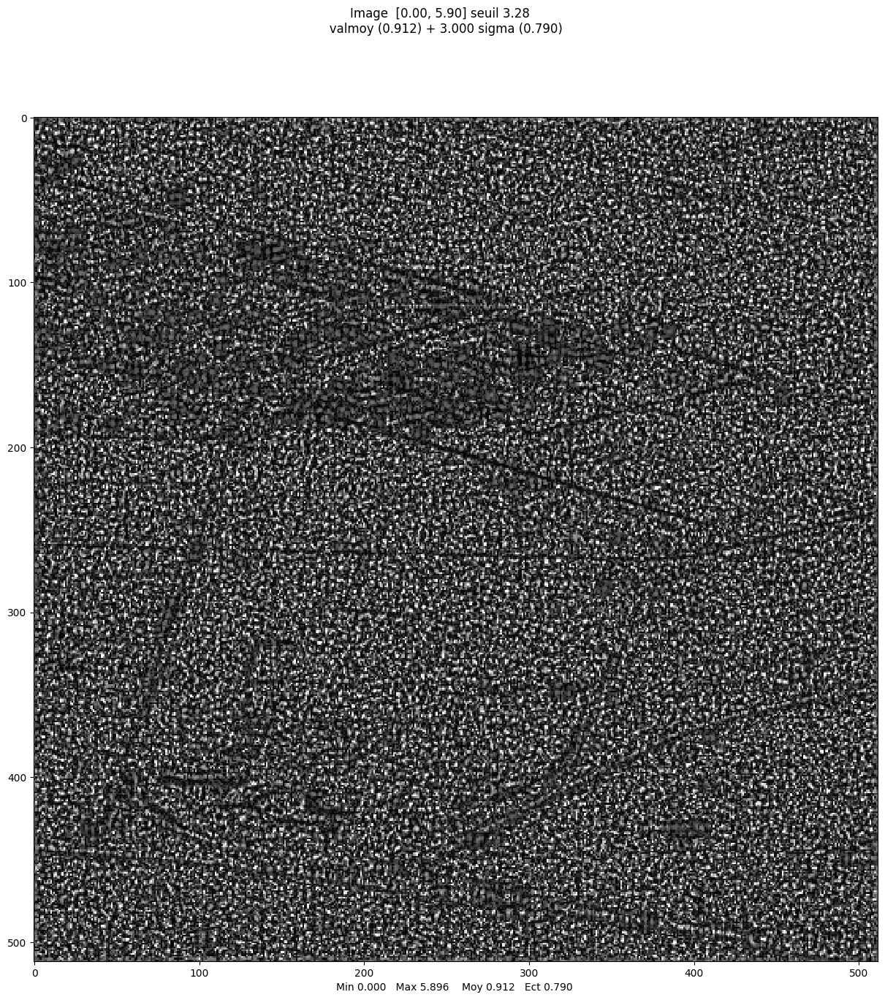

Residual noise after SAR2SAR
Affichage d'une image reelle
plt.show dans visusar : image 512 x 512


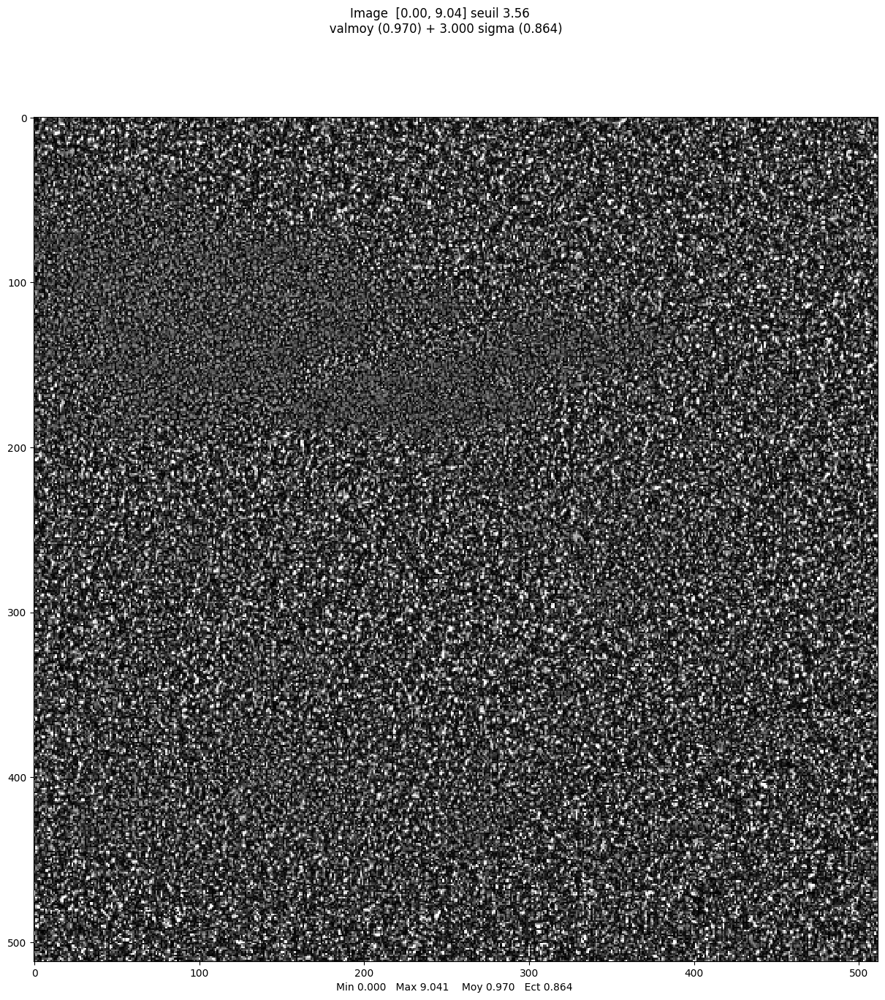

LEE FILTER: mean = 0.9124167702785171 and var = 0.6236372729695344
SAR2SAR: mean = 0.9697834638584217 and var = 0.7457658171745046


In [19]:
# Plot the residual noise
res_noise_lee = part_lely_int/part_lely_int_filtered#complete
print('Residual noise after Lee filter')
mvalab.visusar(res_noise_lee)
mean_lee = np.mean(res_noise_lee)
var_lee = np.var(res_noise_lee)

res_noise_deep =  part_lely_int/im1_d**2 #complete
print('Residual noise after SAR2SAR')
mvalab.visusar(res_noise_deep)
mean_deep = np.mean(res_noise_deep)
var_deep = np.var(res_noise_deep)

print('LEE FILTER: mean = '+str(mean_lee)+' and var = '+str(var_lee))
print('SAR2SAR: mean = '+str(mean_deep)+' and var = '+str(var_deep))